# Combination of annotation methods

#### Working directory should contain root atlas Seurat object, which is available on GEO under record GSE152766:

    Root_Atlas.rds (or get it by running through notebook 2, 3, 4 & 5)

#### Working directory must contain subdirectories,supp_data

#### supp_data/ should contain the files, which are available on Github (github.com/Hsu-Che-Wei/COPILOT):

    Protoplasting_DEgene_FC2_list.txt
    color_scheme_at.RData
    Curated_Markers.csv
    escoring.curated.marker.anno.nsds5.csv (get it by running through notebook 3)
    escoring.curated.marker.csv (get it by running through notebook 3)
    ici_raw_20200414.csv.bz2 (get it by running through notebook 4)

In [1]:
rm(list=ls())
# Set the working directory to where folders named after the samples are located. 
# The folder contains spliced.mtx, unspliced.mtx, barcodes and gene id files, and json files produced by scKB that documents the sequencing stats. 
setwd("/scratch/AG_Ohler/CheWei/scKB")

In [2]:
# Load libraries
suppressMessages(library(Seurat))
suppressMessages(library(scales))
suppressMessages(library(data.table))
suppressMessages(library(tidyverse))
suppressMessages(library(ggplot2))

In [3]:
sessionInfo()

R version 3.6.1 (2019-07-05)
Platform: x86_64-conda_cos6-linux-gnu (64-bit)
Running under: CentOS Linux 7 (Core)

Matrix products: default
BLAS/LAPACK: /fast/home/c/chsu/anaconda3/envs/seu314/lib/libopenblasp-r0.3.9.so

locale:
 [1] LC_CTYPE=en_US.utf-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.utf-8        LC_COLLATE=en_US.utf-8    
 [5] LC_MONETARY=en_US.utf-8    LC_MESSAGES=en_US.utf-8   
 [7] LC_PAPER=en_US.utf-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.utf-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] forcats_0.5.0     stringr_1.4.0     dplyr_1.0.0       purrr_0.3.4      
 [5] readr_1.3.1       tidyr_1.1.0       tibble_3.0.1      ggplot2_3.3.2    
 [9] tidyverse_1.3.0   data.table_1.12.8 scales_1.1.1      Seurat_3.1.5     

loaded via a namespace (and not attached):
 [1] nlme_3.1-148 

## 1. Load data

In [4]:
# Load unwanted genes, which are genes being induced during protoplasting in our case
pp.genes <- as.character(read.table("./supp_data/Protoplasting_DEgene_FC2_list.txt", header=F)$V1)

# Load the color scheme for time and cell type annotation
load("./supp_data/color_scheme_at.RData")

# Load known markers, including both wet-lab validated and in-silico-derived 
known.good.markers <- read.csv("./supp_data/Curated_Markers.csv", header=T)  

# Load escoring output
escore <- read.csv("./supp_data/escoring.curated.marker.anno.nsds5.csv", header=T)
escore <- escore +1
es <- fread("./supp_data/escoring.curated.marker.csv", header = T)

# Load ICI output
ici_raw <- fread("./supp_data/ici_raw_20200414.csv.bz2")

In [6]:
# Read in the atlas
rc.integrated <- readRDS('./Root_Atlas.rds')

## 2. Process escoring output (marker-based annotation)

In [7]:
# A cell is annotated as the label which its marker has the highest escore 
call.index <- apply(es, 2, function(x){colnames(escore)[which(x==max(x))]});
pos.index <- apply(es, 2, function(x){if(max(x)<0){"negative"}else{"positive"}})

escore.anno <- c()
for (i in colnames(escore)){
  ea <- rep('NA',ncol(rc.integrated))  
  ea[escore[,i][!is.na(escore[,i])]] = as.character(known.good.markers$Celltype[match(i,known.good.markers$Locus)])
  escore.anno <- cbind(escore.anno,ea)
} 
spec.index <- apply(escore.anno,1,function(x){length(table(x[x!="NA"]))})

escore.anno <- rep('NA',ncol(rc.integrated)) 
for (i in 1:length(call.index)){ 
  if(pos.index[i] == "positive"){
    escore.anno[i] = as.character(known.good.markers$Celltype[match(call.index[i],known.good.markers$Locus)])
  }
} 

escore.anno[which(spec.index == 0)] <- 'NA'

# Store marker annotation results in atlas
rc.integrated$escore.anno <- escore.anno

## 3. Marker-based annotation

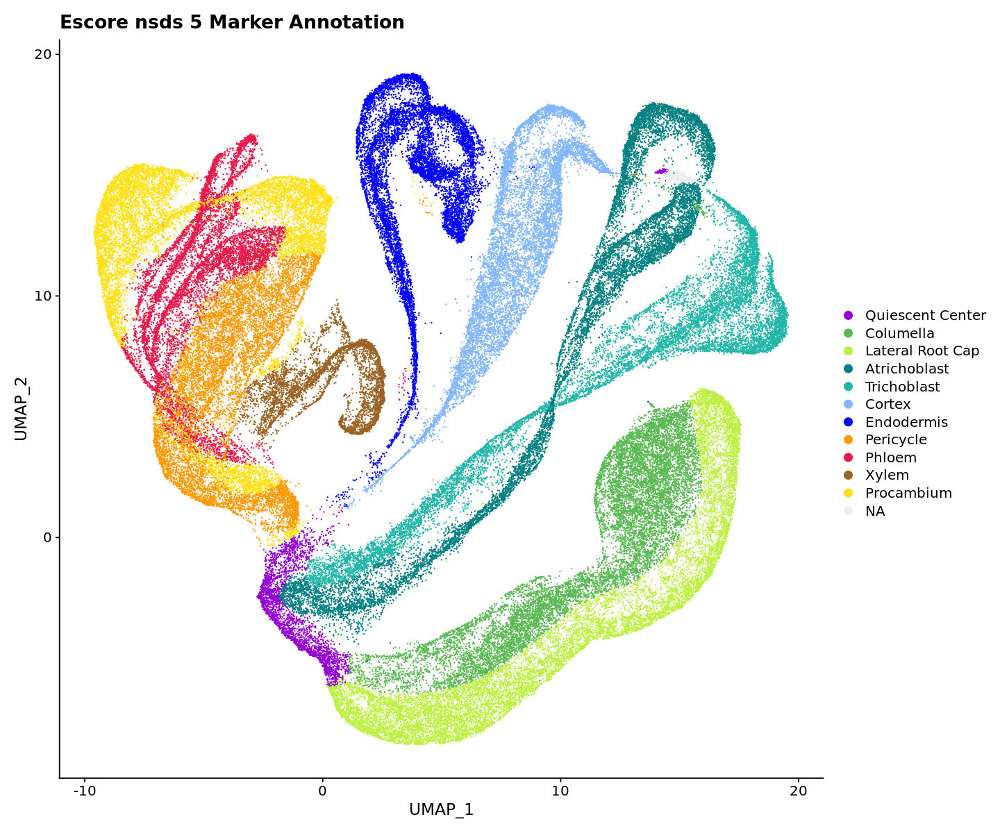

In [13]:
# Plot marker annotation
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "NA")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$escore.anno <- factor(rc.integrated$escore.anno , levels = order[sort(match(unique(rc.integrated$escore.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$escore.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "escore.anno", cols = color)+ggtitle("Escore nsds 5 Marker Annotation")

## 4. Process ICI output

In [5]:
# Select best ICI annotation based on adjusted-pvale and normalized ICI score 
ici_filtered <- ici_raw %>% group_by(Cell) %>% filter(p_adj == min(p_adj)) %>% filter(ici_score_norm == max(ici_score_norm)) %>% filter(p_val == max(p_val)) %>% filter(ici_score == max(ici_score)) 

# Select samples
ici_atlas <- ici_filtered %>% filter(Dataset == 'sc_12'|Dataset == 'sc_11'|Dataset == 'sc_30'|Dataset == 'sc_31'|Dataset == 'sc_37'|Dataset == 'sc_40'|Dataset == 'sc_51'|Dataset == 'sc_9_at'|Dataset == 'sc_10_at'|Dataset == 'sc_1'|Dataset == 'tnw1'|Dataset == 'tnw2'|Dataset == 'col0'|Dataset == 'pp1'|Dataset == 'dc1'|Dataset == 'dc2')

# Store ICI annotation results in atlas
ord <- unique(rc.integrated$orig.ident)
idx <- c()
for (i in 1:length(ord)){
    idx <- c(idx,gsub(paste0("_",i,"$"),"",gsub("^",paste0(ord[i],"_"),colnames(rc.integrated)[grep(paste0("_",i,"$"),colnames(rc.integrated))])))
}
rownames(ici_atlas) <- ici_atlas$Cell
rc.integrated$ici_celltype <- ici_atlas[idx,]$Cell_Type;
rc.integrated$ici_celltype_score <- ici_atlas[idx,]$ici_score;
rc.integrated$ici_celltype_p_val <- ici_atlas[idx,]$p_val;
rc.integrated$ici_celltype_score_norm <- ici_atlas[idx,]$ici_score_norm;
rc.integrated$ici_celltype_p_adj <- ici_atlas[idx,]$p_adj;
ici.order <- unique(rc.integrated$ici_celltype)

# Merge labels
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Columella_Stem")]="Columella";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Ground_Cell_Stem")]="Unknown";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Epidermis_LRC_Stem")]="Lateral_Root_Cap";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Xylem_Stem")]="Meristematic_Xylem";
rc.integrated$ici_celltype[is.na(rc.integrated$ici_celltype)] = "Unknown"

## 5. ICI annotation

Warning message:
“Setting row names on a tibble is deprecated.”


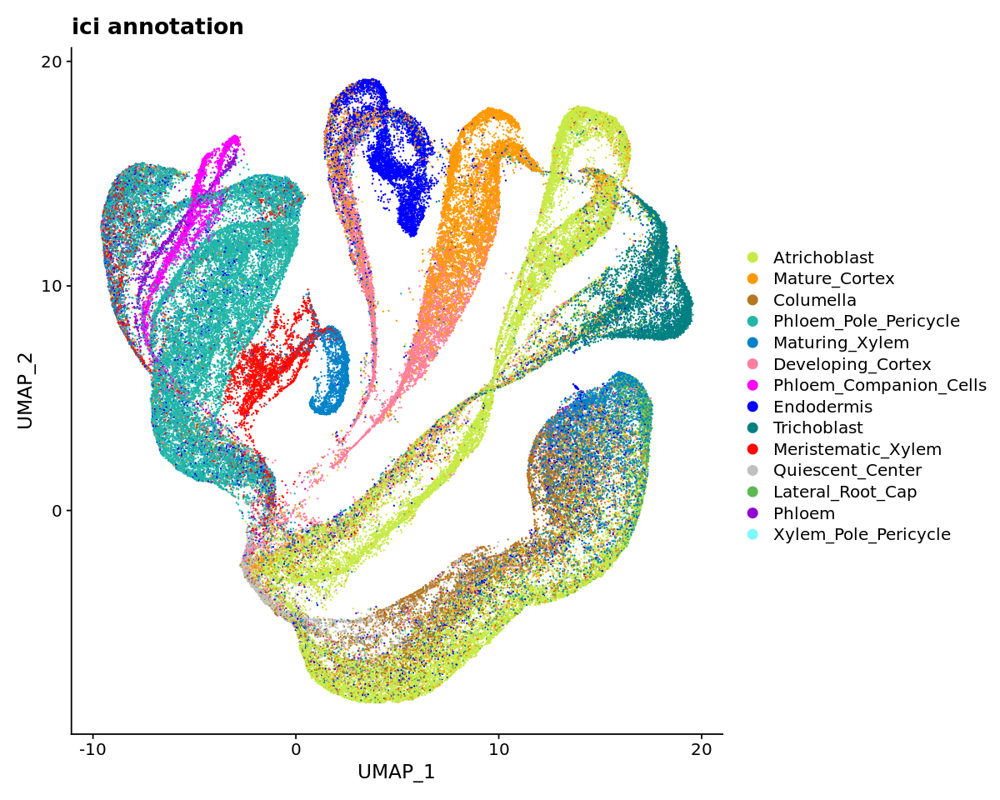

In [15]:
# Plot ICI annotation
ici.order <- unique(rc.integrated$ici_celltype)
ici.palette <- c('#C7EA46','#FF9900','#B67721','#21B6A8','#0082C8','#FE7F9C','#FF00FF','#0000FF','#008081','#FF0800','#C0C0C0','#5AB953','#9400D3','#7EF9FF')
rc.integrated$ici_celltype <- factor(rc.integrated$ici_celltype, levels = ici.order[sort(match(unique(rc.integrated$ici_celltype),ici.order))]) 
color.ici <- ici.palette[sort(match(unique(rc.integrated$ici_celltype),ici.order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "ici_celltype", cols = color.ici)+ggtitle("ici annotation")

## 6. Correlation-based annotation

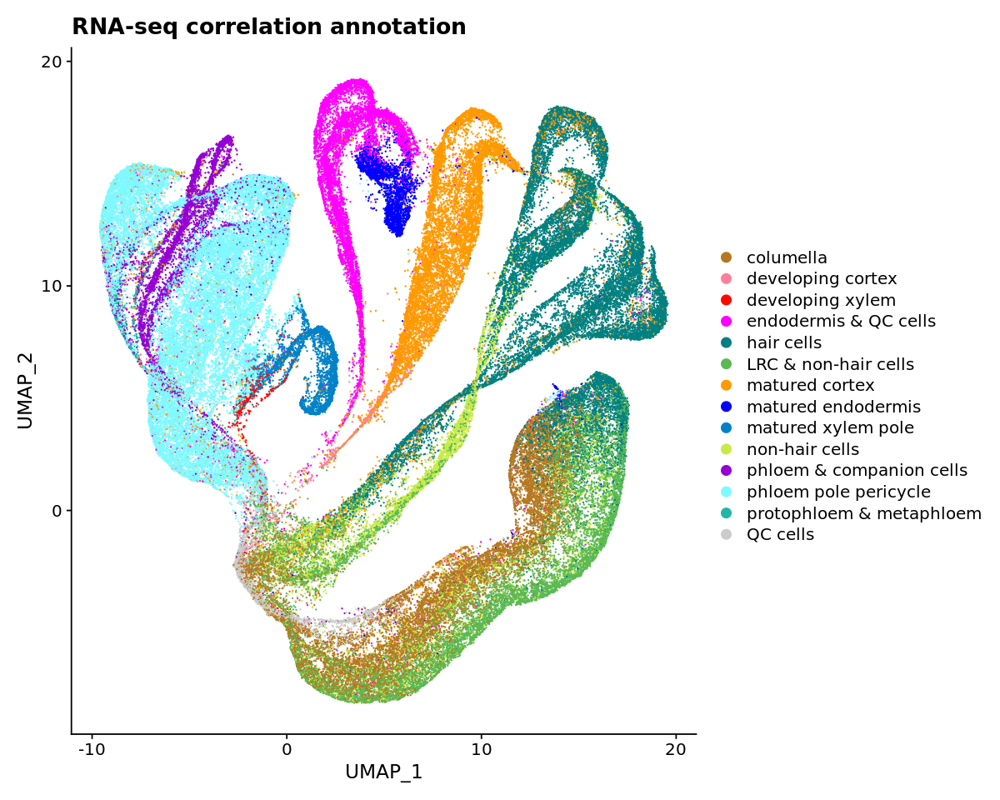

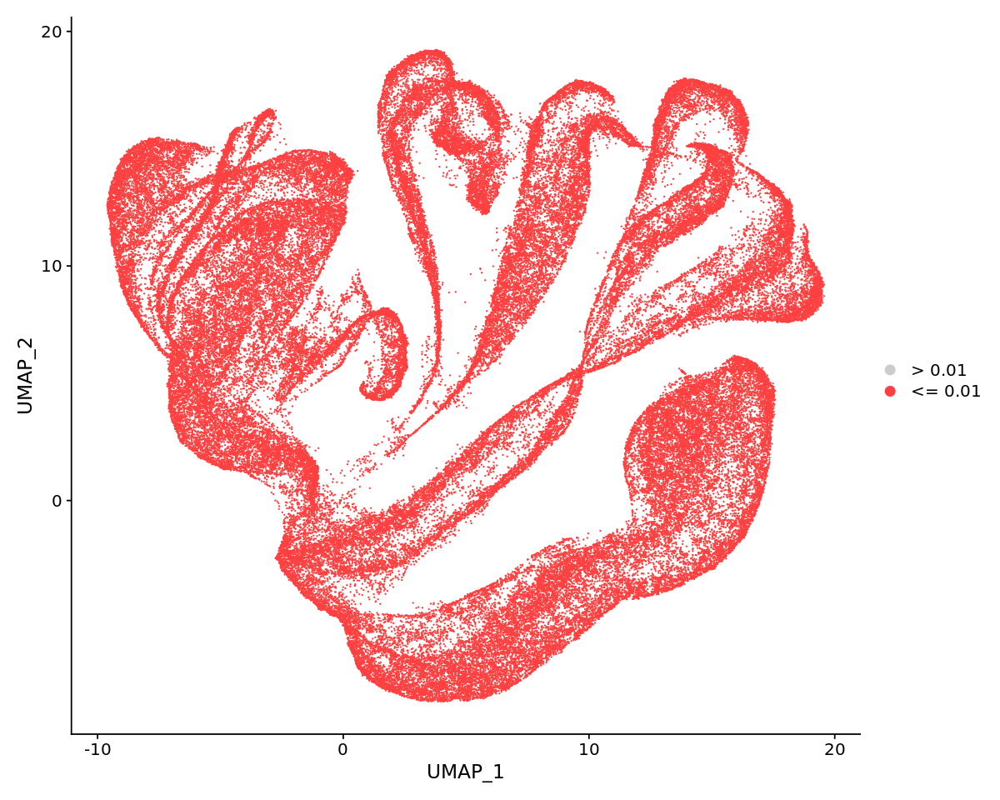

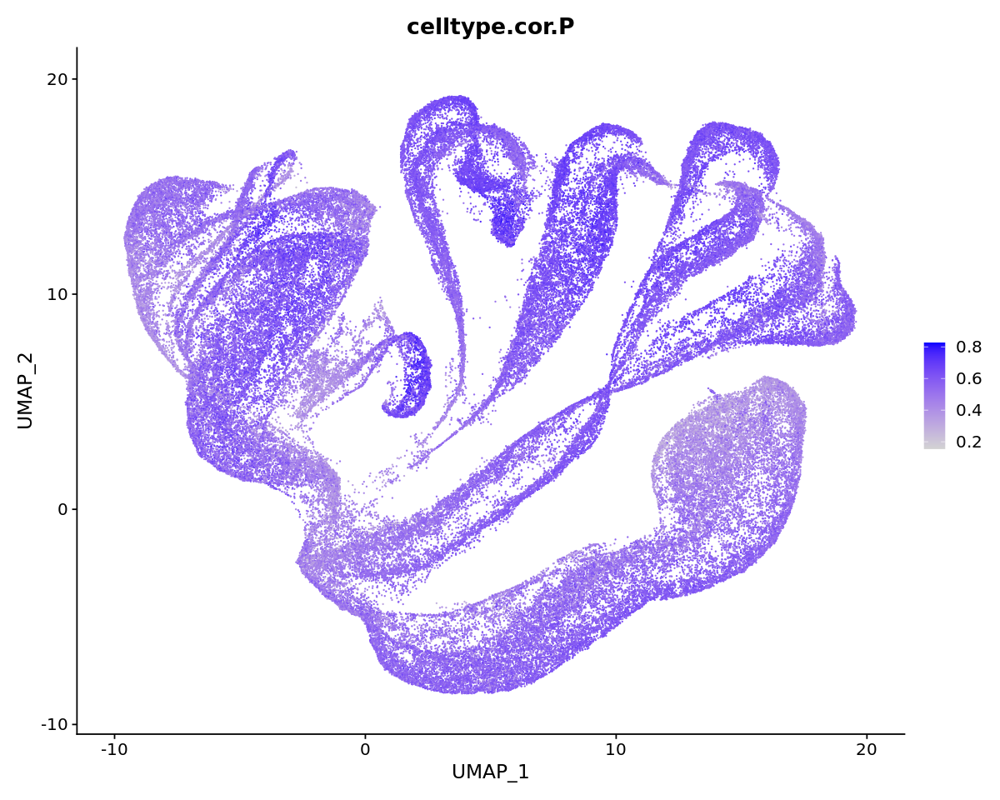

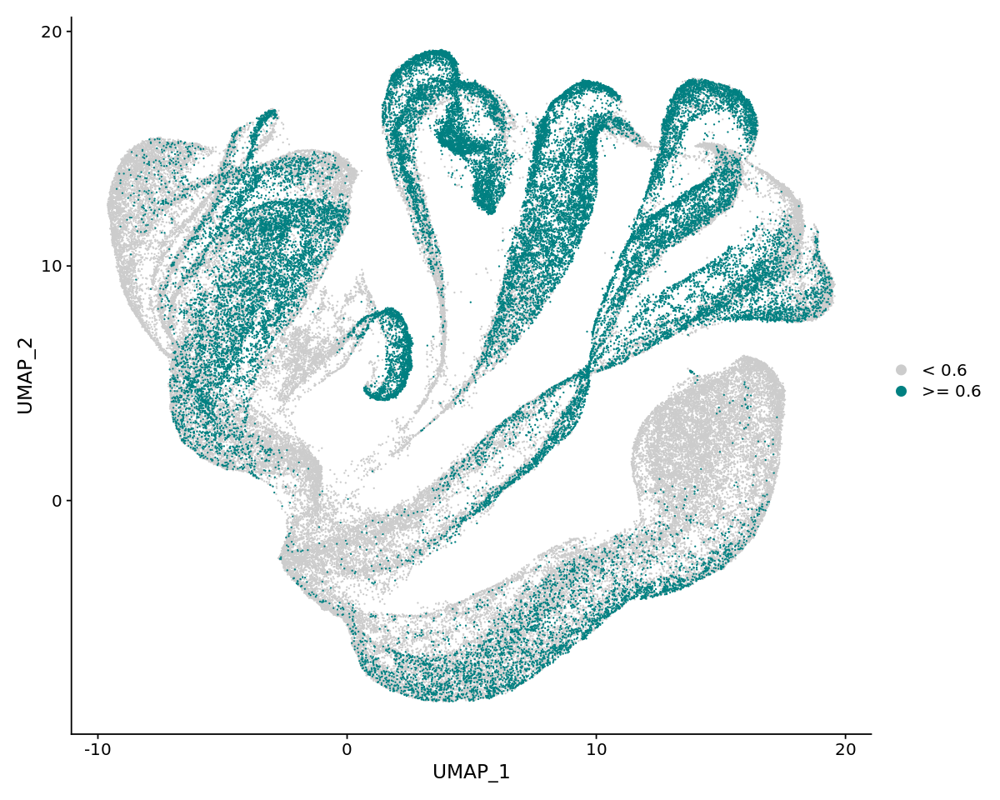

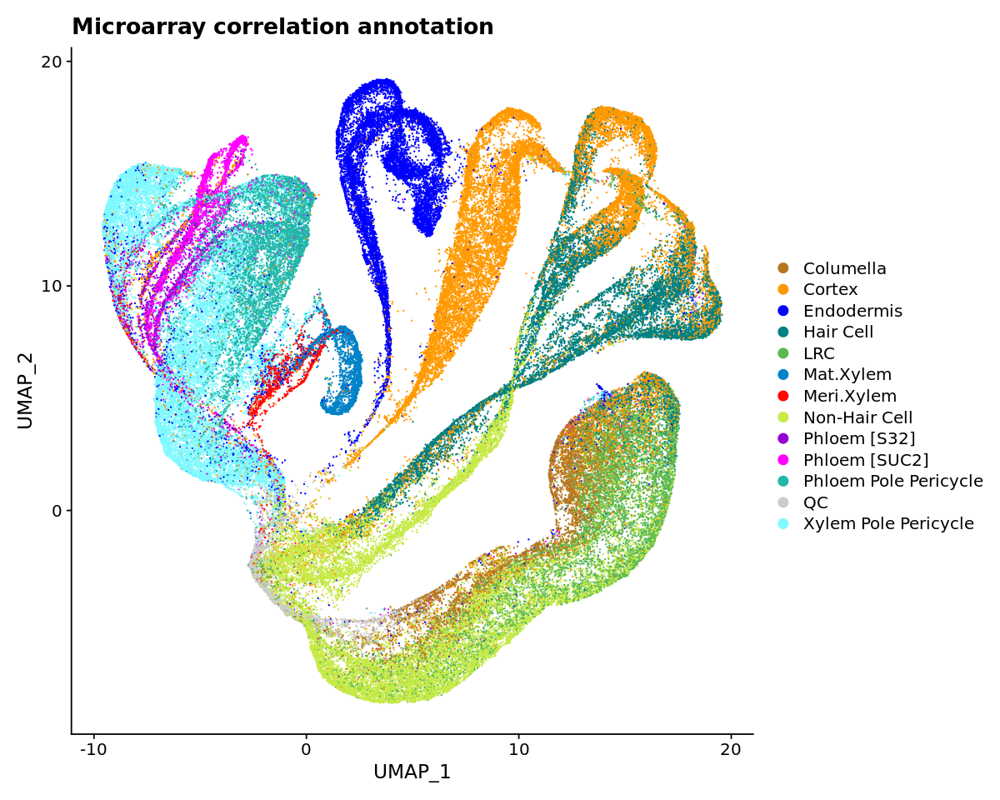

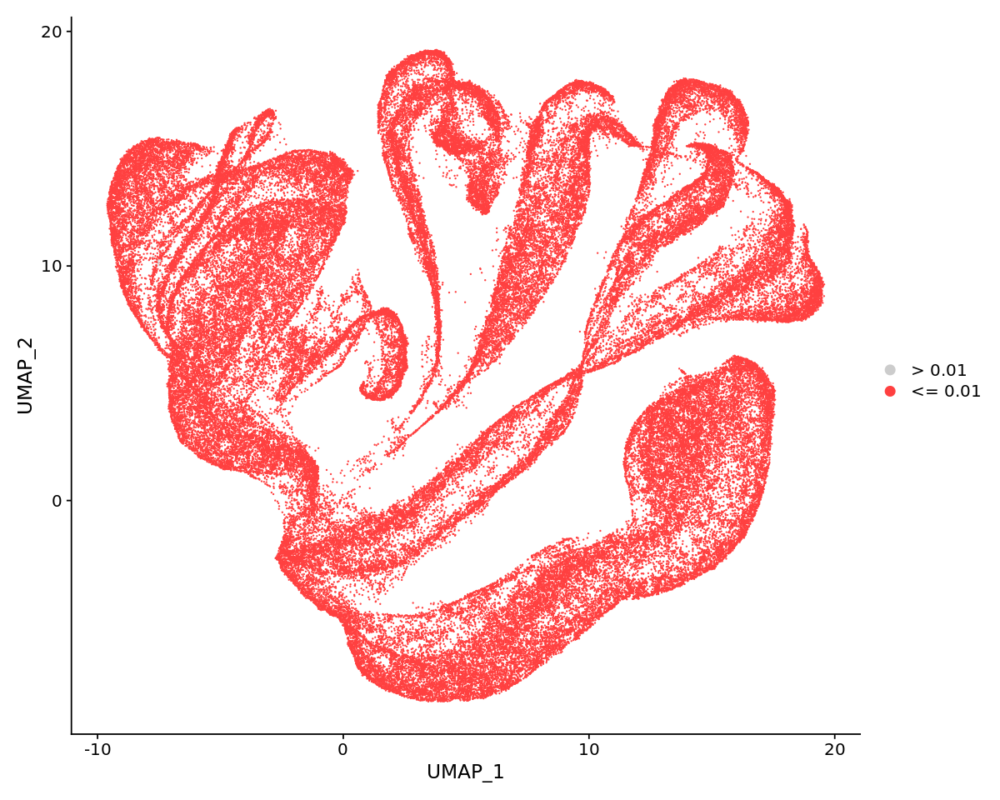

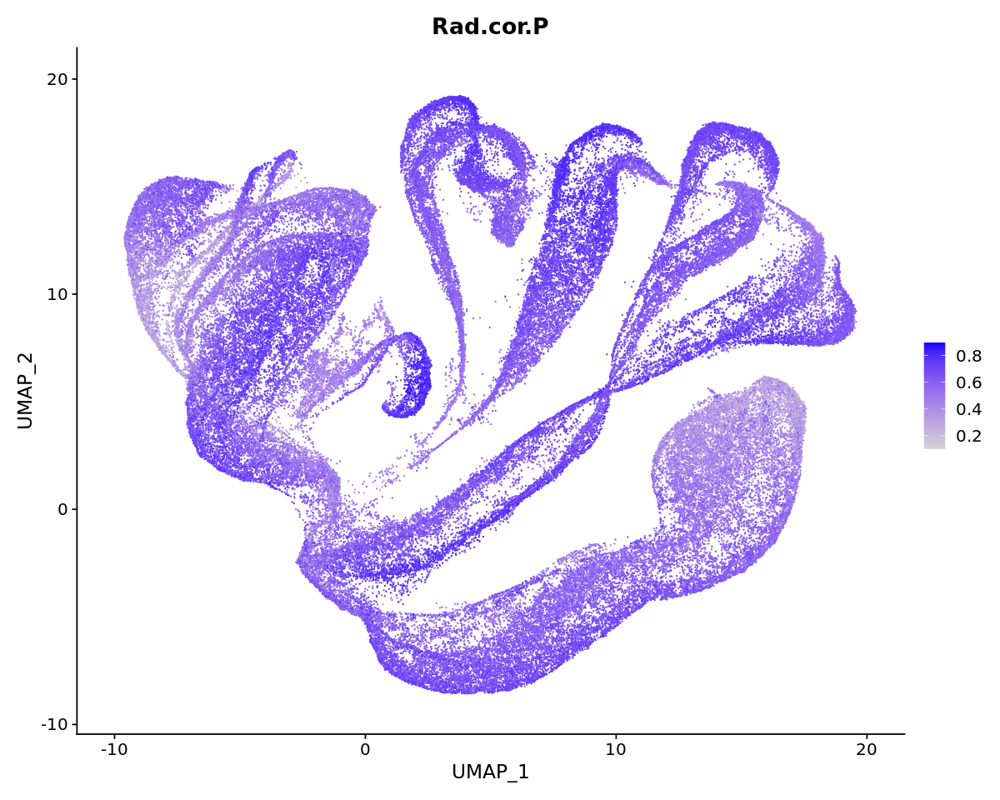

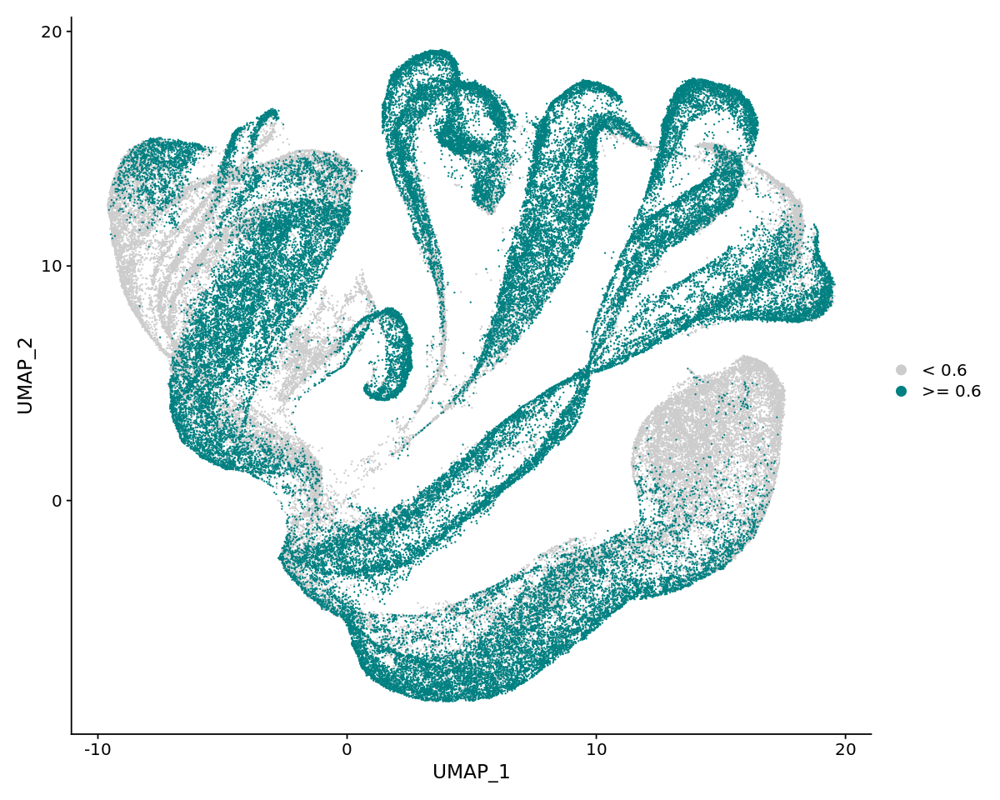

In [17]:
# Plot correlation-based annotation
color <- celltypepalette[sort(match(unique(rc.integrated$celltype.ID.P),celltypeorder))]
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.ID.P", cols = color)+ggtitle("RNA-seq correlation annotation")
rc.integrated$celltype.ID.P_significance <- rep("> 0.01", nrow(rc.integrated@meta.data))
rc.integrated$celltype.ID.P_significance[which(rc.integrated$celltype.pvalue.P <= 0.01)] = "<= 0.01"
rc.integrated$celltype.cor.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$celltype.cor.P_significance[which(rc.integrated$celltype.cor.P < 0.6)] = "< 0.6"
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.ID.P_significance", order = c("<= 0.01","> 0.01"),cols = c("#cccccc", "#ff4040"))
FeaturePlot(rc.integrated, reduction = "umap", features = "celltype.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.cor.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))
rc.integrated$Rad.ID.P <- factor(rc.integrated$Rad.ID.P, levels = radorder[sort(match(unique(rc.integrated$Rad.ID.P),radorder))])
color <- radpalette[sort(match(unique(rc.integrated$Rad.ID.P),radorder))]
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.ID.P", cols = color)+ggtitle("Microarray correlation annotation")
rc.integrated$Rad.ID.P_significance <- rep("> 0.01", nrow(rc.integrated@meta.data))
rc.integrated$Rad.ID.P_significance[which(rc.integrated$Rad.pvalue.P <= 0.01)] = "<= 0.01"
rc.integrated$Rad.cor.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$Rad.cor.P_significance[which(rc.integrated$Rad.cor.P < 0.6)] = "< 0.6"
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.ID.P_significance", order = c("<= 0.01","> 0.01"),cols = c("#cccccc", "#ff4040"))
FeaturePlot(rc.integrated, reduction = "umap", features = "Rad.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.cor.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))

## 7. Make initial consensus annotation

In [46]:
# For making consensus annotation, we only keep those with correlation coefficient > 0.6 and adjusted p-value/p-value < 0.01
# Correlation-based annotation
hc.rna.anno <- as.character(rc.integrated$celltype.ID.P);
hc.rna.anno[which(rc.integrated$celltype.pvalue.P > 0.01)] = "NA";
hc.rna.anno[which(rc.integrated$celltype.cor.P < 0.6)] = "NA";
hc.ma.anno <- as.character(rc.integrated$Rad.ID.P);
hc.ma.anno[which(rc.integrated$Rad.pvalue.P > 0.01)] = "NA";
hc.ma.anno[which(rc.integrated$Rad.cor.P < 0.6)] = "NA";
# ICI annotation
hc.ici.anno <- as.character(rc.integrated$ici_celltype);
hc.ici.anno[which(rc.integrated$ici_celltype_p_adj > 0.01)] = "NA";
# Marker-based annotation
hc.km.anno <- as.character(rc.integrated$escore.anno)

In [47]:
# Merge and unify labels of annotation
hc.km.anno[which(hc.km.anno == "Hair Cells")]="Trichoblast"
hc.km.anno[which(hc.km.anno == "Non-hair Cells")]="Atrichoblast"
hc.km.anno[which(hc.km.anno == "Protophloem sieve elements")]="Phloem"
hc.ma.anno[which(hc.ma.anno == "Hair Cell")]="Trichoblast"
hc.ma.anno[which(hc.ma.anno == "LRC")]="Lateral Root Cap"
hc.ma.anno[which(hc.ma.anno == "Mat.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Meri.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Non-Hair Cell")]="Atrichoblast"
hc.ma.anno[which(hc.ma.anno == "Phloem [S32]")]="Phloem"
hc.ma.anno[which(hc.ma.anno == "Phloem [SUC2]")]="Phloem"
hc.ma.anno[which(hc.ma.anno == "QC")]="Quiescent Center"
hc.ma.anno[which(hc.ma.anno == "Phloem Pole Pericycle")]="Pericycle"
hc.ma.anno[which(hc.ma.anno == "Xylem Pole Pericycle")]="Pericycle"
hc.rna.anno[which(hc.rna.anno == "columella")]="Columella"
hc.rna.anno[which(hc.rna.anno == "developing cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "developing xylem")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "endodermis & QC cells")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "hair cells")]="Trichoblast"
hc.rna.anno[which(hc.rna.anno == "LRC & non-hair cells")]="Lateral Root Cap"
hc.rna.anno[which(hc.rna.anno == "matured cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "matured endodermis")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "matured xylem pole")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "non-hair cells")]="Atrichoblast"
hc.rna.anno[which(hc.rna.anno == "phloem & companion cells")]="Phloem"
hc.rna.anno[which(hc.rna.anno == "phloem pole pericycle")]="Pericycle"
hc.rna.anno[which(hc.rna.anno == "protophloem & metaphloem")]="Phloem"
hc.rna.anno[which(hc.rna.anno == "QC cells")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Mature_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Pole_Pericycle")]="Pericycle"
hc.ici.anno[which(hc.ici.anno == "Maturing_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Developing_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Phloem"
hc.ici.anno[which(hc.ici.anno == "Meristematic_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Quiescent_Center")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Lateral_Root_Cap")]="Lateral Root Cap"
hc.ici.anno[which(hc.ici.anno == "Xylem_Pole_Pericycle")]="Pericycle"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Phloem"

In [48]:
# Merge annotations and metadata
cb.anno <- data.frame(hc.rna.anno=hc.rna.anno,hc.ma.anno=hc.ma.anno,hc.ici.anno=hc.ici.anno,hc.km.anno=hc.km.anno)
num.unique <- apply(cb.anno,1,function(x){length(unique(x[which(x!="NA")]))})
num.not.NA <- apply(cb.anno,1,function(x){length(which(x!="NA"))})
ici.not.NA <- apply(cb.anno,1,function(x){length(which(x[3]!="NA"))})
km.not.NA <- apply(cb.anno,1,function(x){length(which(x[4]!="NA"))})
cb.anno$num.unique <- num.unique 
cb.anno$num.not.NA <- num.not.NA 
cb.anno$ici.not.NA <- ici.not.NA
cb.anno$km.not.NA <- km.not.NA
cb.anno$Cell_ID <- colnames(rc.integrated)
cb.anno$order <- seq(1,ncol(rc.integrated))

# Voting, a cell needs at least two supports from different annotation methods in order to remain annotated. Marker-based annotation is given higher weight on final annotation decision
cb.anno.sub <- cb.anno %>% filter((num.not.NA >= 2 & num.unique <=2 & ici.not.NA==1) | (num.not.NA >= 2 & num.unique <=2 & km.not.NA==1)) 
cb.anno.sub$annotation <- apply(cb.anno.sub,1,function(x){ if (x[3]==x[4] & x[1] == x[2] & x[1]==x[3]){x[4]} else if (x[3]==x[4] & x[3]==x[1]){x[4]} else if (x[3]==x[4] & x[3]==x[2]){x[4]} else if (x[1]==x[2] & x[1]==x[4]){x[4]} else if (x[1]==x[2] & x[1]==x[3]){x[3]} else if ((x[3]=="Quiescent Center"| x[4] == "Quiescent Center") & x[5]==2){"Unknown"} else if ((x[3] == "Phloem" | x[4]=="Phloem") & x[5]==2){"Unknown"} else if ((x[3] == "Pericycle" | x[4]=="Pericycle") & x[5]==2){"Unknown"} else if ((x[3] == "Xylem" | x[4]=="Xylem") & x[5]==2){"Unknown"} else if ((x[3] == "Endodermis" | x[4]=="Endodermis") & x[5]==2){"Unknown"} else if ((x[3] == "Cortex" | x[4]=="Cortex") & x[5]==2){"Unknown"} else if (x[1]==x[2] & x[1]==x[3]){x[3]} else if (x[1]==x[4] & x[4] != "NA"){x[4]} else if (x[2]==x[4] & x[4] != "NA"){x[4]} else if (x[1]==x[3] & x[3] != "NA"){x[3]} else if (x[2]==x[3]  & x[3] != "NA"){x[3]} else if (x[4] == "NA"){x[3]} else {x[4]}})
rc.integrated$cb.anno <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno[as.numeric(cb.anno.sub$order)] <- as.character(cb.anno.sub$annotation)

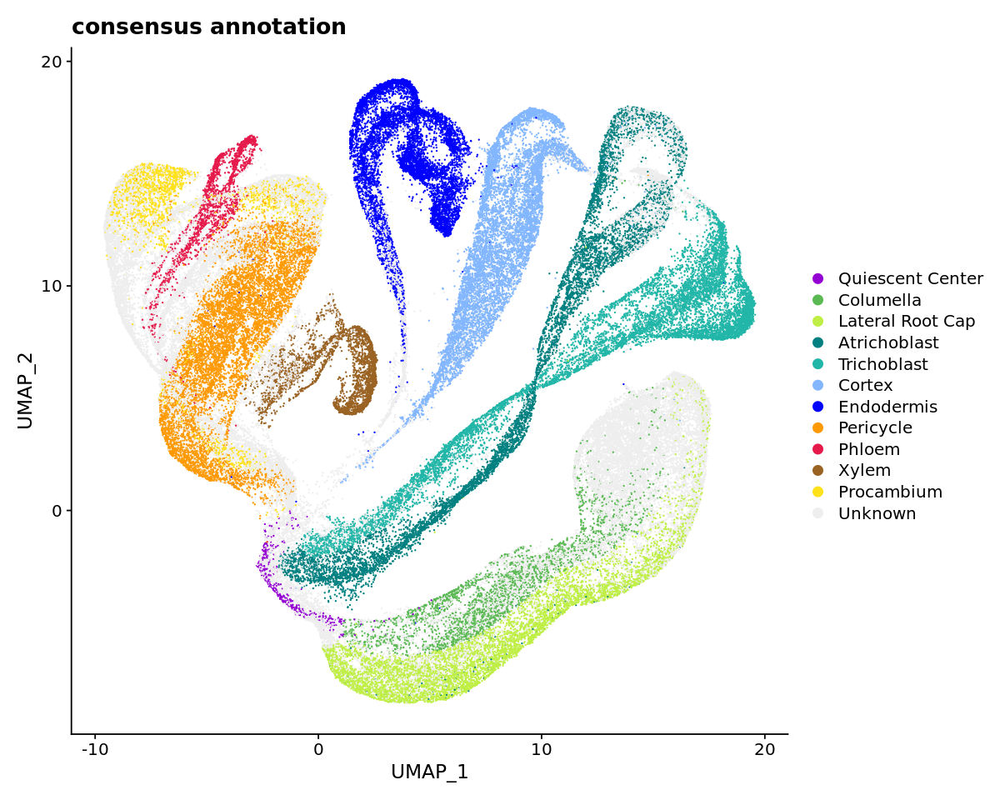

In [49]:
# Plot initial consensus annotation
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$cb.anno <- factor(rc.integrated$cb.anno, levels = order[sort(match(unique(rc.integrated$cb.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$cb.anno),order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "cb.anno", cols = color)+ggtitle("consensus annotation")

## 8. Build new reference expression profiles based on initial consensus annotation 

In [53]:
# Merge cell type consensus annotation with time zone correlation-based annotation
long.merge <- as.character(rc.integrated$Long.ID.P)
cb.anno.t <- data.frame(rna=as.character(rc.integrated$timezone.ID.P), ma=long.merge)
cb.anno.t$order <- seq(1,ncol(rc.integrated))
cb.anno.t$annotation <- apply(cb.anno.t,1,function(x){if(TRUE){x[2]}else{"Unknown"}})
cb.anno.t.sub <- cb.anno.t %>% filter(annotation!="Unknown")
cb.anno.m <- left_join(cb.anno.sub,cb.anno.t.sub,by="order")
cb.anno.m <- cb.anno.m %>% filter(annotation.x != "NA" & annotation.x != "Unknown" & annotation.y != "NA")

# Disect each cell type based on microarray time zone correlation-based annotation to have more grouping of cells/ to give finest resolution 
cb.anno.m$final.annotation <- paste(cb.anno.m$annotation.y, cb.anno.m$annotation.x, sep="-")

In [55]:
# Filter grouping that has too few cells
cb.anno.m$final.annotation[grep(paste(names(table(cb.anno.m$final.annotation)[which(table(cb.anno.m$final.annotation) <= 2)]),collapse = "|"),cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m <- cb.anno.m %>% filter(final.annotation != "Unknown")

# 88 new reference expression profiles are going to be build
length(sort(table(cb.anno.m$final.annotation)))
rc.integrated$cb.anno <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno[as.numeric(cb.anno.m$order)] <- as.character(cb.anno.m$final.annotation)

[1] 88

In [56]:
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:88) {
m <- afm[,which(rc.integrated$cb.anno==as.character(unique(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes 
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge 88 newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [58]:
colnames(nr)[1:89]

[1] "Meri-5-Atrichoblast"        "Elong-7-Cortex"            
 [3] "Meri-3-Lateral Root Cap"    "Meri-5-Lateral Root Cap"   
 [5] "Elong-8-Pericycle"          "Elong-8-Xylem"             
 [7] "Elong-8-Endodermis"         "Elong-8-Phloem"            
 [9] "Mat-10-Cortex"              "Mat-11-Columella"          
[11] "Mat-10-Atrichoblast"        "Elong-8-Procambium"        
[13] "Meri-6-Trichoblast"         "Mat-10-Procambium"         
[15] "Elong-7-Atrichoblast"       "Meri-6-Cortex"             
[17] "Mat-10-Trichoblast"         "Elong-7-Endodermis"        
[19] "Meri-1-Columella"           "Elong-7-Trichoblast"       
[21] "Elong-7-Procambium"         "Mat-11-Trichoblast"        
[23] "Mat-10-Xylem"               "Meri-3-Atrichoblast"       
[25] "Meri-3-Columella"           "Meri-5-Columella"          
[27] "Mat-10-Endodermis"          "Meri-3-Pericycle"          
[29] "Mat-11-Lateral Root Cap"    "Mat-11-Atrichoblast"       
[31] "Meri-5-Trichoblast"         "Elong-7-Xylem"             
[33] "Meri-2-Atrichoblast"        "Mat-11-Cortex"             
[35] "Mat-11-Pericycle"           "Meri-6-Atrichoblast"       
[37] "Elong-7-Lateral Root Cap"   "Meri-3-Trichoblast"        
[39] "Elong-8-Cortex"             "Meri-2-Quiescent Center"   
[41] "Mat-10-Pericycle"           "Meri-5-Cortex"             
[43] "Meri-1-Lateral Root Cap"    "Elong-7-Pericycle"         
[45] "Mat-9-Trichoblast"          "Meri-2-Lateral Root Cap"   
[47] "Meri-5-Phloem"              "Meri-5-Xylem"              
[49] "Mat-11-Phloem"              "Meri-3-Cortex"             
[51] "Mat-11-Xylem"               "Mat-10-Lateral Root Cap"   
[53] "Mat-11-Procambium"          "Mat-10-Phloem"             
[55] "Meri-3-Procambium"          "Elong-7-Columella"         
[57] "Elong-8-Trichoblast"        "Meri-3-Xylem"              
[59] "Meri-6-Phloem"              "Meri-3-Quiescent Center"   
[61] "Meri-2-Columella"           "Elong-8-Atrichoblast"      
[63] "Elong-7-Phloem"             "Meri-3-Endodermis"         
[65] "Mat-10-Columella"           "Meri-1-Xylem"              
[67] "Mat-11-Endodermis"          "Mat-9-Endodermis"          
[69] "Elong-8-Columella"          "Meri-5-Pericycle"          
[71] "Meri-4-Lateral Root Cap"    "Meri-4-Xylem"              
[73] "Meri-5-Endodermis"          "Meri-4-Atrichoblast"       
[75] "Meri-3-Phloem"              "Mat-9-Cortex"              
[77] "Meri-6-Xylem"               "Meri-4-Columella"          
[79] "Meri-6-Lateral Root Cap"    "Meri-1-Atrichoblast"       
[81] "Meri-5-Procambium"          "Meri-6-Columella"          
[83] "Mat-12-Lateral Root Cap"    "Mat-9-Lateral Root Cap"    
[85] "Columella-Lateral Root Cap" "Mat-9-Columella"           
[87] "Mat-12-Phloem"              "Meri-2-Procambium"         
[89] "AAACCCAAGCCATTCA_1"

In [59]:
# Correlation-based annotation using 88 newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply(89:ncol(nr), function(i) sapply(1:88, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        
nr_max <- sapply(1:(ncol(nr)-88), function(i) max(as.numeric(nr_cor[,i])))
nr_ident <- sapply(1:(ncol(nr)-88), function(i) nr_label[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])
nr_maxp <- sapply(1:(ncol(nr)-88), function(i) as.numeric(nr_pvalue[,i])[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])                     
names(nr_max) <- nr_ident
rc.integrated$final.anno.P <- as.character(nr_ident)
rc.integrated$final.anno.cor.P <- as.numeric(nr_max)
rc.integrated$final.anno.pvalue.P <- as.numeric(nr_maxp)
rc.integrated$final.anno.wo.unknown <-  gsub("^Columella-","",gsub("^Meri-.*-","",gsub("^Elong-.*-","",gsub("^Mat-.*-","",as.character(rc.integrated$final.anno.P)))))

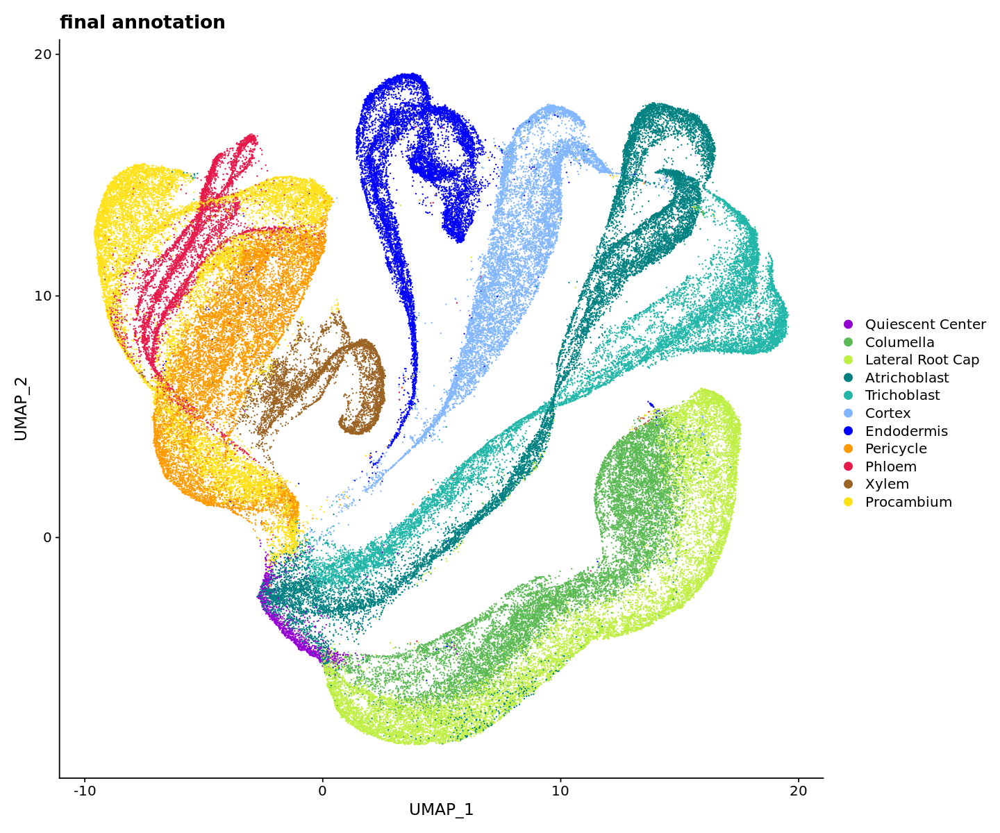

In [60]:
# Plot new correlation-based annotation
rc.integrated$final.anno.wo.unknown <-  gsub("^Columella-","",gsub("^Meri-.*-","",gsub("^Elong-.*-","",gsub("^Mat-.*-","",as.character(rc.integrated$final.anno.P)))))
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$final.anno.wo.unknown <- factor(rc.integrated$final.anno.wo.unknown, levels = order[sort(match(unique(rc.integrated$final.anno.wo.unknown),order))]) 
color <- palette[sort(match(unique(rc.integrated$final.anno.wo.unknown),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "final.anno.wo.unknown", cols = color)+ggtitle("final annotation")

In [61]:
# Store index of QC
QC.idx <- which(rc.integrated$final.anno.wo.unknown=="Quiescent Center")

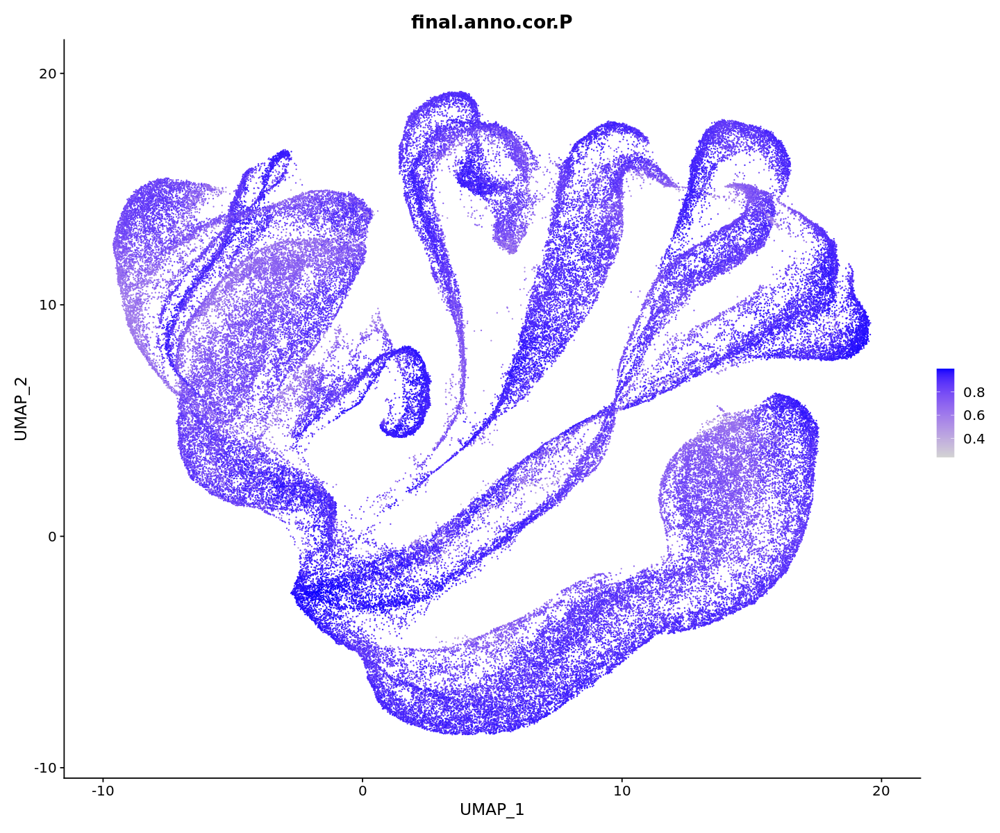

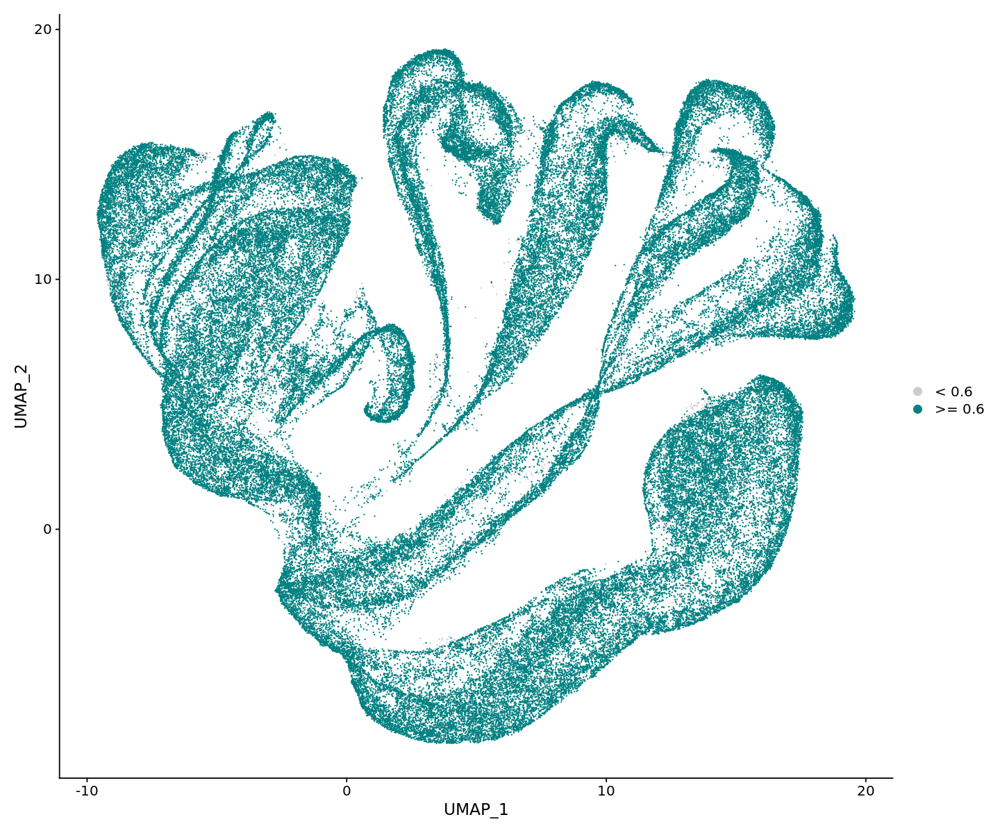

In [62]:
# Plot correlation coefficient
rc.integrated$final.anno.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$final.anno.P_significance[which(rc.integrated$final.anno.cor.P < 0.6)] = "< 0.6"
FeaturePlot(rc.integrated, reduction = "umap", features = "final.anno.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "final.anno.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))

## 9. Make second consensus annotation

In [66]:
# Make second consensus annotation by keeping annotation of those in agreement with marker-based annotation
cb.anno.df <- data.frame(order = seq(1,ncol(rc.integrated)),escore.anno = as.character(rc.integrated$escore.anno), final.anno.wo.unknown = as.character(rc.integrated$final.anno.wo.unknown))
cb.anno.df$selected <- apply(cb.anno.df, 1 ,function(x){if (x[2]==x[3]) {x[2]} else {"Unknown"}})

In [67]:
rc.integrated$cb.anno.2 <- cb.anno.df$selected

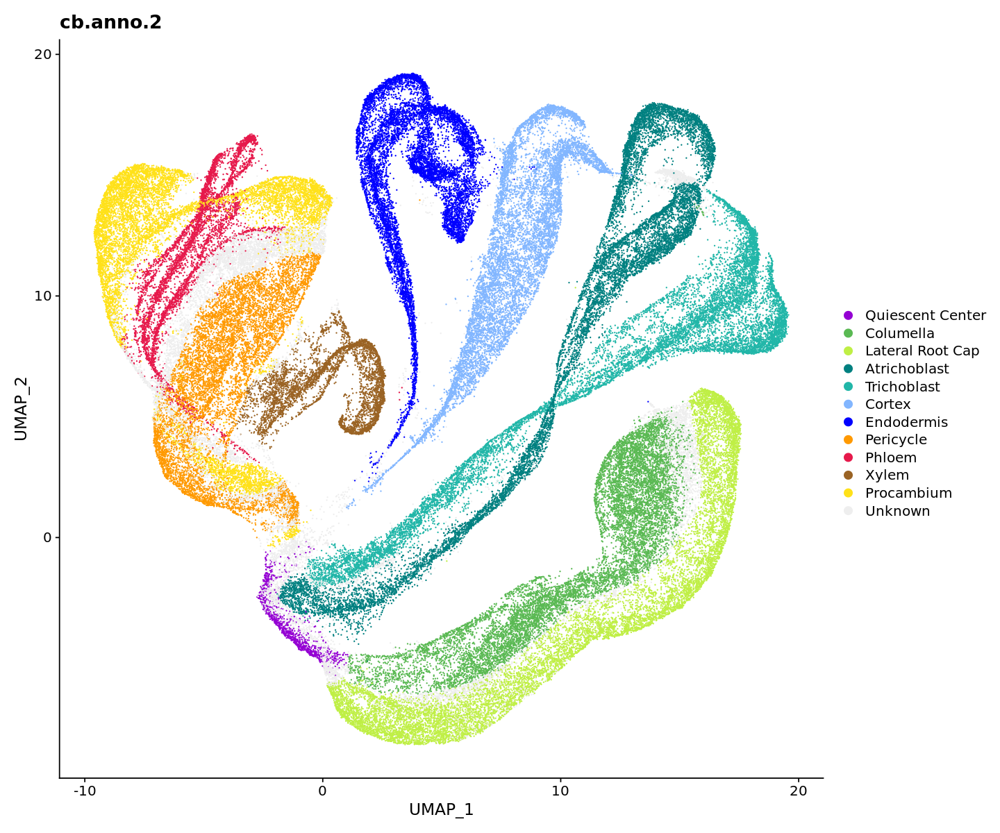

In [68]:
# Plot second consensus annotation
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$cb.anno.2 <- factor(rc.integrated$cb.anno.2, levels = order[sort(match(unique(rc.integrated$cb.anno.2),order))]) 
color <- palette[sort(match(unique(rc.integrated$cb.anno.2),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "cb.anno.2", cols = color)+ggtitle("cb.anno.2")

## 10. Derive time zone annotation on second consensus annotation by leveraging microarray, RNA-seq and CytoTRACE information

In [69]:
# Merge cell type consensus annotation with time zone correlation-based annotation
long.merge <- as.character(rc.integrated$Long.ID.P)
long.merge[grep("Meri",long.merge)]="Meristem";
long.merge[grep("Elong",long.merge)]="Elongation";
long.merge[grep("Mat",long.merge)]="Maturation";
long.merge[grep("Columella",long.merge)]="Maturation"
cb.anno.t <- data.frame(rna=as.character(rc.integrated$timezone.ID.P), ma=long.merge)
cb.anno.t$order <- seq(1,ncol(rc.integrated))

# Keep cell annotation of those having the same label of microarray and RNA-seq correlation-based time zone annotation 
cb.anno.t$annotation <- apply(cb.anno.t,1,function(x){if(x[1]==x[2]){x[2]}else{"Unknown"}})
cb.anno.t.sub <- cb.anno.t %>% filter(annotation!="Unknown")

In [70]:
cb.anno.m <- left_join(cb.anno.df,cb.anno.t.sub,by="order")

In [71]:
cb.anno.m <- cb.anno.m %>% filter(selected != "Unknown") %>% filter(annotation == "Meristem" | annotation == "Elongation" | annotation == "Maturation")

In [72]:
cb.anno.m$final.annotation <- paste(cb.anno.m$annotation, cb.anno.m$selected, sep="-")

In [73]:
sort(table(cb.anno.m$final.annotation))


Elongation-Quiescent Center         Meristem-Endodermis 
                          9                          79 
             Meristem-Xylem           Maturation-Phloem 
                         91                         171 
            Meristem-Phloem             Meristem-Cortex 
                        171                         179 
       Maturation-Pericycle         Meristem-Procambium 
                        250                         350 
         Meristem-Pericycle Elongation-Lateral Root Cap 
                        413                         456 
      Maturation-Procambium            Maturation-Xylem 
                        505                         553 
Maturation-Lateral Root Cap        Elongation-Columella 
                        560                         603 
  Meristem-Quiescent Center        Meristem-Trichoblast 
                       1088                        1512 
          Maturation-Cortex     Maturation-Atrichoblast 
                       2066   

In [74]:
# Filter grouping that has too few cells
cb.anno.m$final.annotation[grep(paste(names(table(cb.anno.m$final.annotation)[which(table(cb.anno.m$final.annotation) <= 20)]),collapse = "|"),cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m <- cb.anno.m %>% filter(final.annotation != "Unknown")

# 31 new reference expression profiles 
length(sort(table(cb.anno.m$final.annotation)))
rc.integrated$cb.anno.t <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno.t[as.numeric(cb.anno.m$order)] <- as.character(cb.anno.m$final.annotation)

[1] 31

In [75]:
# Load CytoTRACE results
cb.anno.m$CytoTRACE <- rc.integrated$CytoTRACE[cb.anno.m$order]

In [76]:
sub <- cb.anno.m %>% group_by(final.annotation) %>% arrange(final.annotation,CytoTRACE)

In [77]:
sub

order,escore.anno,final.anno.wo.unknown,selected,rna,ma,annotation,final.annotation,CytoTRACE
<int>,<fct>,<fct>,<chr>,<fct>,<fct>,<chr>,<chr>,<dbl>
1784,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
13977,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
14649,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
15184,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
20937,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
21761,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
24329,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
27021,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705
30075,Atrichoblast,Atrichoblast,Atrichoblast,Elongation,Elongation,Elongation,Elongation-Atrichoblast,0.04704705


In [78]:
# Counsult CytoTRACE to produce finer groupping
sub1 <- sub %>%
  group_by(final.annotation) %>%
  summarise(median(CytoTRACE), n())
Group <- c()
for (i in 1:nrow(sub1)) {
  a <- rep(sub1$`median(CytoTRACE)`[i], sub1$`n()`[i])
  Group <- c(Group, a)
}
sub$Median_cycto <- Group
sub2 <- sub %>%
  mutate(Group = ifelse(test = CytoTRACE >= Median_cycto, yes = "G1",
                        no = "G2"))
Check <- sub2 %>%
  group_by(final.annotation, Group) %>%
  summarise(n())

In [79]:
sub2$cttz <- paste(sub2$final.annotation, sub2$Group, sep="-")

In [80]:
sort(table(sub2$cttz))


        Meristem-Endodermis-G2         Meristem-Endodermis-G1 
                            39                             40 
             Meristem-Xylem-G2              Meristem-Xylem-G1 
                            41                             50 
          Maturation-Phloem-G2             Meristem-Cortex-G2 
                            61                             76 
            Meristem-Phloem-G2             Meristem-Phloem-G1 
                            84                             87 
            Meristem-Cortex-G1           Maturation-Phloem-G1 
                           103                            110 
       Maturation-Pericycle-G2        Maturation-Pericycle-G1 
                           113                            137 
        Meristem-Procambium-G2         Meristem-Procambium-G1 
                           155                            195 
         Meristem-Pericycle-G2          Meristem-Pericycle-G1 
                           199                        

In [81]:
sub2 <- sub2 %>% filter(cttz != "Unknown")
sub2$cttz[grep("Meristem-Quiescent Center",sub2$cttz)] = "Meristem-Quiescent Center";
sub2$cttz[grep("Meristem-Lateral Root Cap",sub2$cttz)] = "Meristem-Lateral Root Cap";
sub2$cttz[grep("Elongation-Lateral Root Cap",sub2$cttz)] = "Elongation-Lateral Root Cap";
sub2$cttz[grep("Maturation-Lateral Root Cap",sub2$cttz)] = "Maturation-Lateral Root Cap";
sub2$cttz[grep("Meristem-Columella",sub2$cttz)] = "Meristem-Columella";
sub2$cttz[grep("Elongation-Columella",sub2$cttz)] = "Elongation-Columella";
sub2$cttz[grep("Maturation-Columella",sub2$cttz)] = "Maturation-Columella";

# 55 new reference expression profiles are going to be build
length(sort(table(sub2$cttz)))
rc.integrated$cb.anno.t <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno.t[as.numeric(sub2$order)] <- as.character(sub2$cttz)

[1] 55

In [82]:
table(rc.integrated$cb.anno.t)


 Elongation-Atrichoblast-G1  Elongation-Atrichoblast-G2 
                       2190                        2190 
       Elongation-Columella        Elongation-Cortex-G1 
                        603                        2713 
       Elongation-Cortex-G2    Elongation-Endodermis-G1 
                       2708                        2824 
   Elongation-Endodermis-G2 Elongation-Lateral Root Cap 
                       2785                         456 
    Elongation-Pericycle-G1     Elongation-Pericycle-G2 
                       3515                        3457 
       Elongation-Phloem-G1        Elongation-Phloem-G2 
                       1926                        1922 
   Elongation-Procambium-G1    Elongation-Procambium-G2 
                       3707                        3673 
  Elongation-Trichoblast-G1   Elongation-Trichoblast-G2 
                       1934                        1874 
        Elongation-Xylem-G1         Elongation-Xylem-G2 
                       1171   

In [83]:
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:55) {
m <- afm[,which(rc.integrated$cb.anno.t==as.character(unique(rc.integrated$cb.anno.t[which(rc.integrated$cb.anno.t!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$cb.anno.t[which(rc.integrated$cb.anno.t!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge 55 newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}
nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [85]:
colnames(nr)[1:56]

[1] "Elongation-Atrichoblast-G2"  "Elongation-Cortex-G2"       
 [3] "Meristem-Lateral Root Cap"   "Elongation-Pericycle-G1"    
 [5] "Elongation-Endodermis-G2"    "Elongation-Atrichoblast-G1" 
 [7] "Elongation-Phloem-G2"        "Meristem-Quiescent Center"  
 [9] "Maturation-Cortex-G2"        "Meristem-Atrichoblast-G2"   
[11] "Elongation-Pericycle-G2"     "Maturation-Trichoblast-G1"  
[13] "Maturation-Atrichoblast-G1"  "Maturation-Cortex-G1"       
[15] "Meristem-Phloem-G2"          "Elongation-Procambium-G1"   
[17] "Maturation-Procambium-G1"    "Maturation-Atrichoblast-G2" 
[19] "Maturation-Columella"        "Meristem-Atrichoblast-G1"   
[21] "Maturation-Lateral Root Cap" "Elongation-Xylem-G1"        
[23] "Elongation-Cortex-G1"        "Maturation-Trichoblast-G2"  
[25] "Elongation-Endodermis-G1"    "Meristem-Columella"         
[27] "Elongation-Phloem-G1"        "Elongation-Trichoblast-G1"  
[29] "Maturation-Xylem-G2"         "Elongation-Procambium-G2"   
[31] "Maturation-Pericycle-G1"     "Maturation-Endodermis-G2"   
[33] "Elongation-Trichoblast-G2"   "Maturation-Xylem-G1"        
[35] "Maturation-Pericycle-G2"     "Elongation-Lateral Root Cap"
[37] "Meristem-Trichoblast-G1"     "Elongation-Columella"       
[39] "Maturation-Procambium-G2"    "Elongation-Xylem-G2"        
[41] "Maturation-Endodermis-G1"    "Meristem-Cortex-G1"         
[43] "Meristem-Trichoblast-G2"     "Meristem-Pericycle-G2"      
[45] "Meristem-Procambium-G2"      "Meristem-Pericycle-G1"      
[47] "Meristem-Procambium-G1"      "Maturation-Phloem-G2"       
[49] "Maturation-Phloem-G1"        "Meristem-Cortex-G2"         
[51] "Meristem-Endodermis-G1"      "Meristem-Xylem-G1"          
[53] "Meristem-Phloem-G1"          "Meristem-Xylem-G2"          
[55] "Meristem-Endodermis-G2"      "AAACCCAAGCCATTCA_1"

In [86]:
# Correlation-based annotation using 55 newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply(56:ncol(nr), function(i) sapply(1:55, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        

In [87]:
# Update timezone-celltype annotation on second consensus annotation 
final.anno.P <- rep("Unknown",ncol(rc.integrated))
final.anno.cor.P <- rep(0,ncol(rc.integrated))
ct.list <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium")

for (j in ct.list){
    tm.idx <- grep(j,nr_label)
    ct.idx <- grep(j,rc.integrated$cb.anno.2)
    nr_max <- sapply(ct.idx, function(i) max(as.numeric(nr_cor[tm.idx,i])))
    nr_ident <- sapply(ct.idx, function(i) nr_label[tm.idx][which(as.numeric(nr_cor[tm.idx,i])==max(as.numeric(nr_cor[tm.idx,i])))])
    names(nr_max) <- nr_ident
    final.anno.P[ct.idx] <- as.character(nr_ident)
    final.anno.cor.P[ct.idx] <- as.numeric(nr_max)
} 

In [88]:
# Store updated timezone-celltype annotation 
rc.integrated$final.anno.P <- final.anno.P
rc.integrated$final.anno.cor.P <- final.anno.cor.P

In [89]:
table(rc.integrated$cb.anno.2.time)


Elongation Maturation   Meristem    Unknown 
     44681      28597      23705      13444 

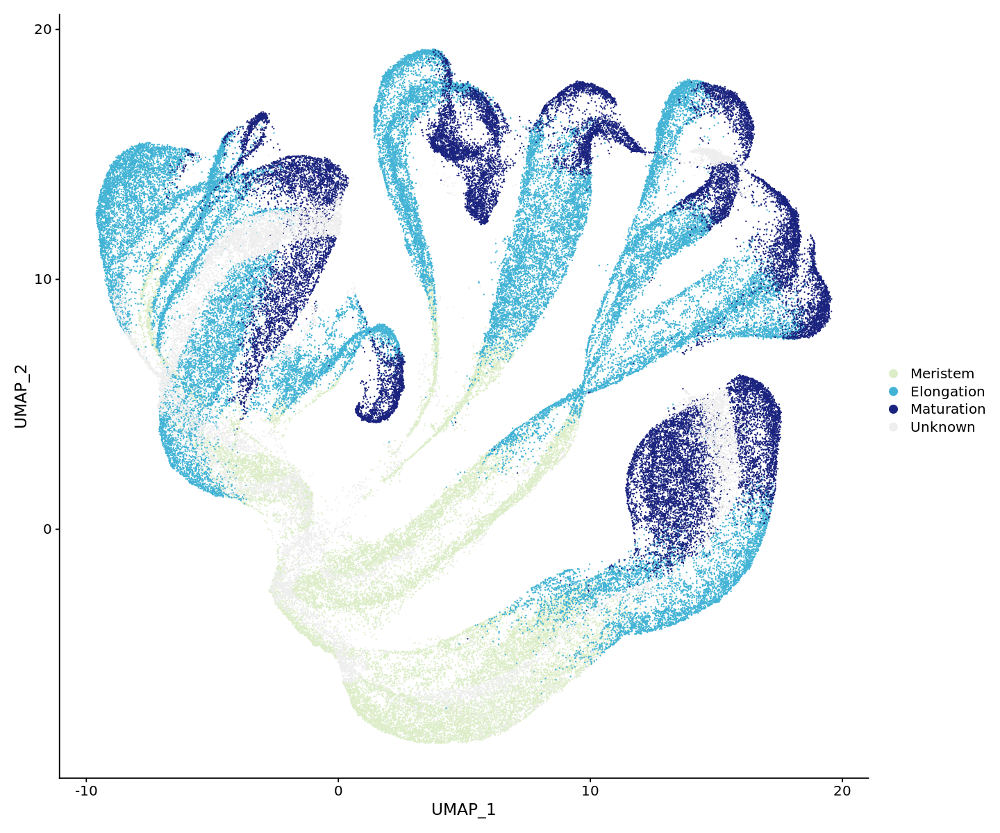

In [90]:
# Plot timezone annotation of second consensus annotation
rc.integrated$cb.anno.2.time <- gsub("-.*$","",gsub("-.*-G2$","",gsub("-.*-G1$","",as.character(rc.integrated$final.anno.P))))
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "cb.anno.2.time", order = c("Unknown","Maturation","Elongation","Meristem"),cols = c("#DCEDC8", "#42B3D5", "#1A237E", "#EEEEEE"))

## 11. Final annotation

In [92]:
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:55) {
m <- afm[,which(rc.integrated$final.anno.P==as.character(unique(rc.integrated$final.anno.P[which(rc.integrated$final.anno.P!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$final.anno.P[which(rc.integrated$final.anno.P!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge 55 newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}
nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [93]:
str(nr)
colnames(nr)[1:56]

 num [1:200, 1:110482] -1.8187 -0.0305 -1.805 -0.873 -1.1245 ...
 - attr(*, "dimnames")=List of 2
  ..$ : chr [1:200] "AT1G02900" "AT1G03870" "AT1G05260" "AT1G07640" ...
  ..$ : chr [1:110482] "Meristem-Atrichoblast-G2" "Elongation-Atrichoblast-G1" "Elongation-Cortex-G2" "Elongation-Columella" ...


[1] "Meristem-Atrichoblast-G2"    "Elongation-Atrichoblast-G1" 
 [3] "Elongation-Cortex-G2"        "Elongation-Columella"       
 [5] "Maturation-Columella"        "Meristem-Lateral Root Cap"  
 [7] "Elongation-Xylem-G2"         "Elongation-Lateral Root Cap"
 [9] "Maturation-Pericycle-G2"     "Elongation-Endodermis-G2"   
[11] "Elongation-Atrichoblast-G2"  "Elongation-Phloem-G2"       
[13] "Maturation-Procambium-G1"    "Meristem-Quiescent Center"  
[15] "Elongation-Pericycle-G2"     "Maturation-Trichoblast-G1"  
[17] "Maturation-Atrichoblast-G1"  "Maturation-Pericycle-G1"    
[19] "Elongation-Pericycle-G1"     "Maturation-Cortex-G2"       
[21] "Meristem-Phloem-G1"          "Elongation-Procambium-G1"   
[23] "Meristem-Endodermis-G2"      "Maturation-Xylem-G2"        
[25] "Elongation-Trichoblast-G1"   "Maturation-Procambium-G2"   
[27] "Meristem-Atrichoblast-G1"    "Elongation-Endodermis-G1"   
[29] "Elongation-Cortex-G1"        "Maturation-Lateral Root Cap"
[31] "Maturation-Cortex-G1"        "Maturation-Atrichoblast-G2" 
[33] "Elongation-Xylem-G1"         "Meristem-Columella"         
[35] "Maturation-Endodermis-G1"    "Elongation-Phloem-G1"       
[37] "Meristem-Phloem-G2"          "Meristem-Procambium-G2"     
[39] "Maturation-Trichoblast-G2"   "Elongation-Trichoblast-G2"  
[41] "Elongation-Procambium-G2"    "Maturation-Endodermis-G2"   
[43] "Meristem-Pericycle-G2"       "Maturation-Phloem-G1"       
[45] "Meristem-Trichoblast-G2"     "Meristem-Cortex-G2"         
[47] "Maturation-Phloem-G2"        "Maturation-Xylem-G1"        
[49] "Meristem-Trichoblast-G1"     "Meristem-Xylem-G2"          
[51] "Meristem-Pericycle-G1"       "Meristem-Cortex-G1"         
[53] "Meristem-Xylem-G1"           "Meristem-Endodermis-G1"     
[55] "Meristem-Procambium-G1"      "AAACCCAAGCCATTCA_1"

In [94]:
# Correlation-based annotation using 55 newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply(56:ncol(nr), function(i) sapply(1:55, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        
nr_max <- sapply(1:(ncol(nr)-55), function(i) max(as.numeric(nr_cor[,i])))
nr_ident <- sapply(1:(ncol(nr)-55), function(i) nr_label[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])
nr_maxp <- sapply(1:(ncol(nr)-55), function(i) as.numeric(nr_pvalue[,i])[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])                     
names(nr_max) <- nr_ident
rc.integrated$final.anno.P <- as.character(nr_ident)
rc.integrated$final.anno.cor.P <- as.numeric(nr_max)
rc.integrated$final.anno.pvalue.P <- as.numeric(nr_maxp)

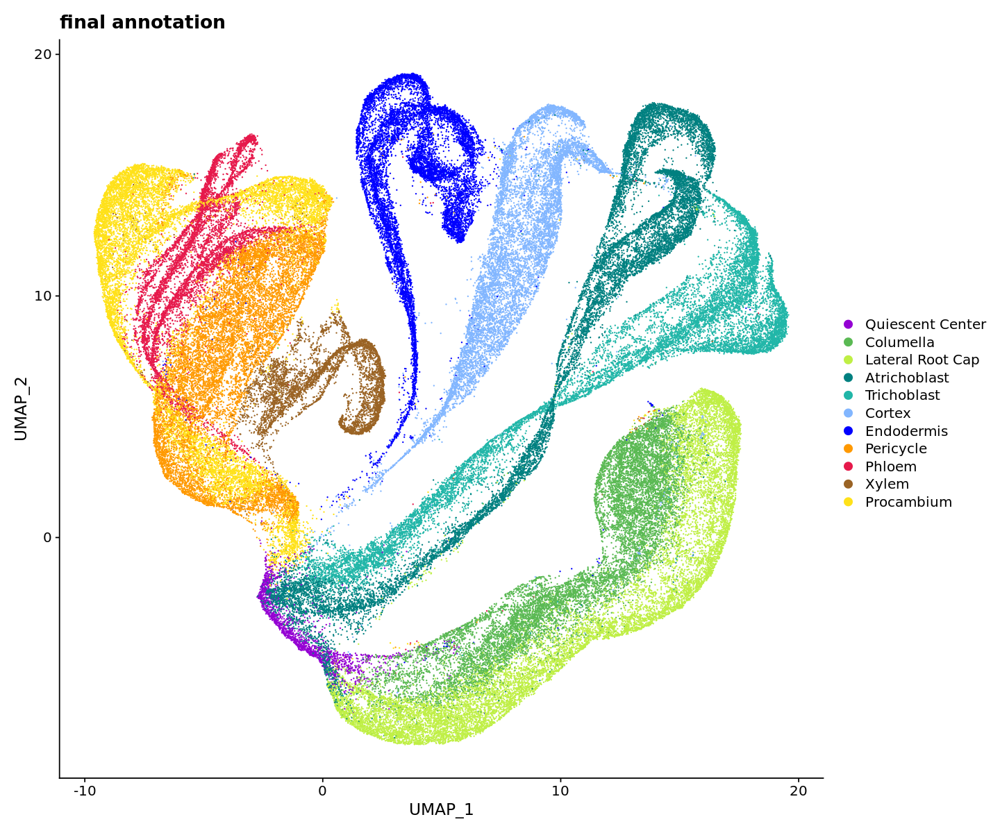

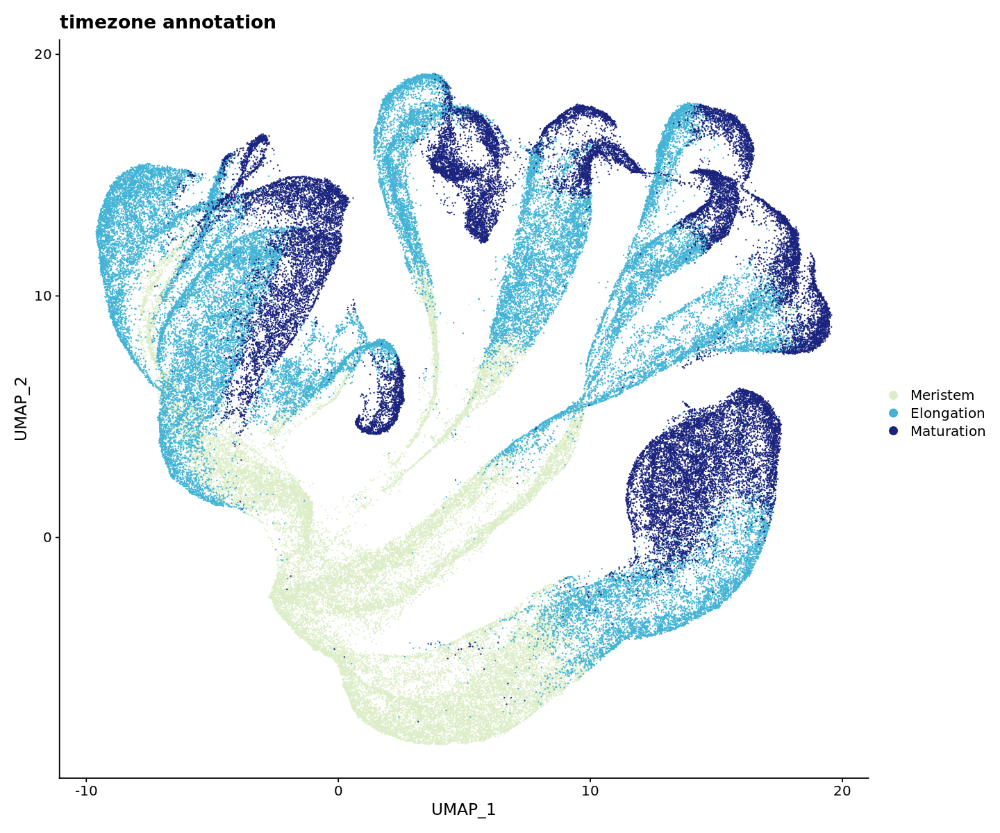

In [95]:
# Plot new correlation-based annotation
rc.integrated$final.anno.wo.unknown <-  gsub("-G1$","",gsub("-G2$","",gsub("^Meristem-","",gsub("^Elongation-","",gsub("^Maturation-","",as.character(rc.integrated$final.anno.P))))))
rc.integrated$time.anno <- gsub("-.*$","",as.character(rc.integrated$final.anno.P))
order <- c("Quiescent Center", "Stem Cell Niche", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400D3","#dcd0ff", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$final.anno.wo.unknown <- factor(rc.integrated$final.anno.wo.unknown, levels = order[sort(match(unique(rc.integrated$final.anno.wo.unknown),order))]) 
color <- palette[sort(match(unique(rc.integrated$final.anno.wo.unknown),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "final.anno.wo.unknown", cols = color)+ggtitle("final annotation")
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno", order = c("Unknown","Maturation","Elongation","Meristem"),cols = c("#DCEDC8", "#42B3D5", "#1A237E", "#EEEEEE"))+ggtitle("timezone annotation")

## 12. Final touch (manually correct/adjust annotation)

In [96]:
# Extract annotations
tc.anno <- gsub("-G1$","",gsub("-G2$","",rc.integrated$final.anno.P))
tm.anno <- gsub("-.*$","",tc.anno)
ct.anno <- gsub("^Meristem-","",gsub("^Elongation-","",gsub("^Maturation-","",tc.anno)))

In [100]:
tc.anno <- paste(tm.anno, ct.anno, sep="-")
tc.anno[which(tc.anno=="Elongation-Putative Quiescent Center")]="Meristem-Putative Quiescent Center";
tc.anno[which(tc.anno=="Maturation-Putative Quiescent Center")]="Meristem-Putative Quiescent Center";
tc.anno[which(tc.anno=="Maturation-Stem Cell Niche")]="Meristem-Stem Cell Niche";
tc.anno[which(tc.anno=="Elongation-Stem Cell Niche")]="Meristem-Stem Cell Niche";

In [102]:
tm.anno <- gsub("-.*$","",tc.anno)
ct.anno <- gsub("^Meristem-","",gsub("^Elongation-","",gsub("^Maturation-","",tc.anno)))

In [103]:
# Annotation for Columella, LRC and Stem Cell Niche relies solely on marker-based annotation
LRC.idx <- which(rc.integrated$escore.anno=="Lateral Root Cap");
CLM.idx <- which(rc.integrated$escore.anno=="Columella");
ct.anno[which(ct.anno=="Quiescent Center")]="Stem Cell Niche"
ct.anno[LRC.idx] = "Lateral Root Cap"
ct.anno[CLM.idx] = "Columella"
tmp <- paste(tm.anno, ct.anno, sep="-")
SCN.idx <- which(rc.integrated$escore.anno=="Quiescent Center" & tmp!="Maturation-Atrichoblast");
ct.anno[SCN.idx] = "Stem Cell Niche"
ct.anno[QC.idx] = "Putative Quiescent Center" 
tc.anno <- paste(tm.anno, ct.anno, sep="-")

In [104]:
# Store final annotation
rc.integrated$celltype.anno <- ct.anno
rc.integrated$time.anno <- tm.anno
rc.integrated$time.celltype.anno <- tc.anno

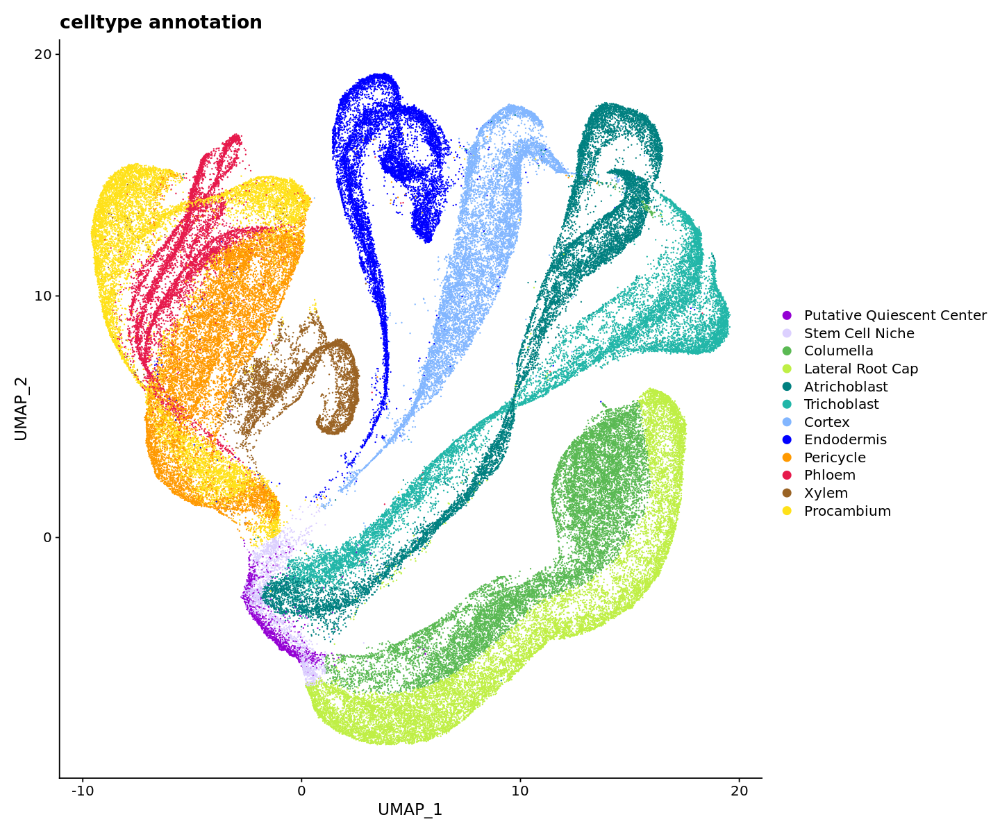

In [105]:
# Plot final cell type annotation
order <- c("Putative Quiescent Center", "Stem Cell Niche", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400D3","#dcd0ff", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno, levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype annotation")

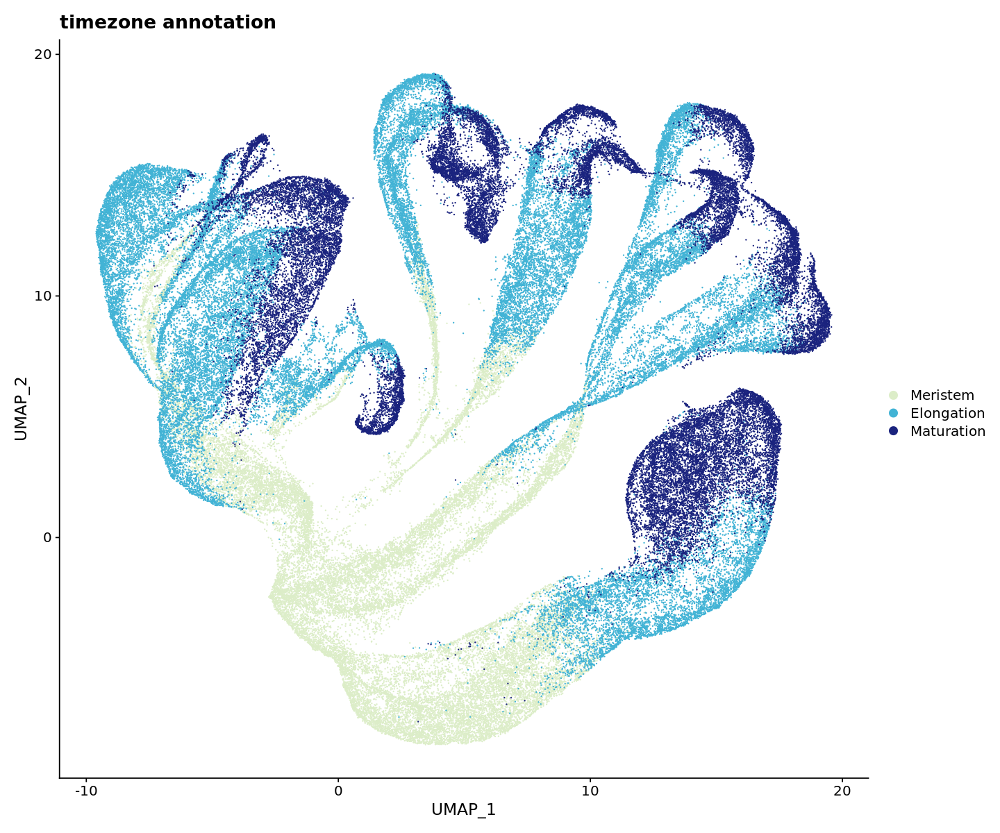

In [106]:
# Plot final time zone annotation
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno", order = c("Unknown","Maturation","Elongation","Meristem"),cols = c("#DCEDC8", "#42B3D5", "#1A237E", "#EEEEEE"))+ggtitle("timezone annotation")

In [111]:
# Save Seurat object
saveRDS(rc.integrated, file='./Root_Atlas.rds')